# Kidney Segmentation

## Images are filtered by Canny filter

Original Image 1: kidney_segmentation/1-3-46-670589-33-1-63700700749865510700001-5062181202000819812_png_jpg.rf.269520bcaab75e008e00f57f3fa98851.jpg
Edge-Detected Image 1: Edge of kidney_segmentation/1-3-46-670589-33-1-63700700749865510700001-5062181202000819812_png_jpg.rf.269520bcaab75e008e00f57f3fa98851.jpg
Original Image 2: kidney_segmentation/1-3-46-670589-33-1-63705452817813079700001-4930177024992105378_png_jpg.rf.6b480b2d494a96b4e2d4143fa12b6f92.jpg
Edge-Detected Image 2: Edge of kidney_segmentation/1-3-46-670589-33-1-63705452817813079700001-4930177024992105378_png_jpg.rf.6b480b2d494a96b4e2d4143fa12b6f92.jpg
Original Image 3: kidney_segmentation/1-3-46-670589-33-1-63705534437778071900001-4889285351602499583_png_jpg.rf.285306b4b622f3066164f801d91bce86.jpg
Edge-Detected Image 3: Edge of kidney_segmentation/1-3-46-670589-33-1-63705534437778071900001-4889285351602499583_png_jpg.rf.285306b4b622f3066164f801d91bce86.jpg
Original Image 4: kidney_segmentation/1-3-46-670589-33-1-6370553443

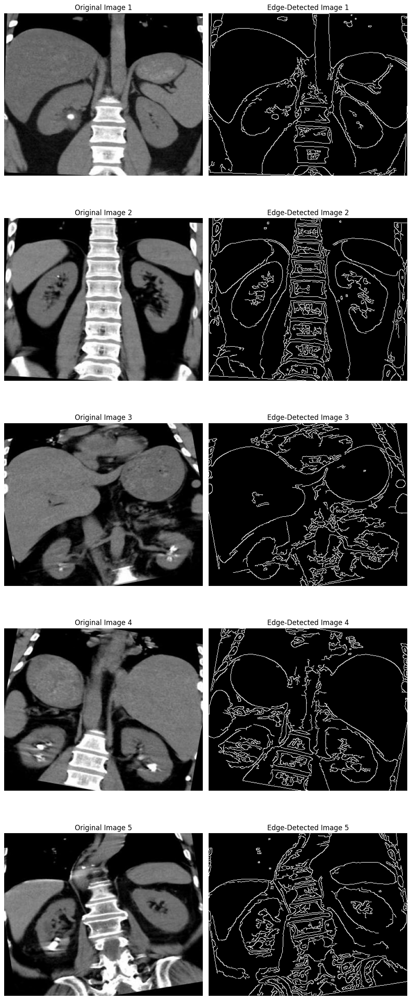

In [7]:
import cv2
import os
import matplotlib.pyplot as plt

# Define the folder containing the images
folder_path = "kidney_segmentation/"

# Ensure the folder path exists
if not os.path.exists(folder_path):
    print(f"Folder '{folder_path}' not found.")
    exit()

# Get a list of image files in the folder
image_files = [os.path.join(folder_path, file) for file in os.listdir(folder_path) ] 

# Create a Matplotlib figure to display the images
num_images = len(image_files)
experiment_images = 5
fig, axes = plt.subplots(experiment_images, 2, figsize=(10, 5 * experiment_images))

# Loop through all images in the folder
for i, image_path in enumerate(image_files):

    # Read the original image
    original_image = cv2.imread(image_path)

    # Check if the image was successfully loaded
    if original_image is None:
        print(f"Failed to read image: {image_path}")
        continue

    # Perform edge detection using the Canny edge detector
    edge_image = cv2.Canny(original_image, 50, 200)  

    # Display the original and edge-detected images using Matplotlib
    axes[i, 0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title(f"Original Image {i+1}")
    axes[i, 0].axis('off')

    axes[i, 1].imshow(edge_image, cmap='gray')
    axes[i, 1].set_title(f"Edge-Detected Image {i+1}")
    axes[i, 1].axis('off')

    # Print the paths of the images being processed
    print(f"Original Image {i+1}: {image_path}")
    print(f"Edge-Detected Image {i+1}: Edge of {image_path}")
    if(i == experiment_images - 1):
        break
    


# Show the Matplotlib figure
plt.tight_layout()
plt.show()


## Images are filtered by Sharpening filter followed by Canny filter

Original Image 1: kidney_segmentation/1-3-46-670589-33-1-63700700749865510700001-5062181202000819812_png_jpg.rf.269520bcaab75e008e00f57f3fa98851.jpg
Sharpened Image 1: Sharpened kidney_segmentation/1-3-46-670589-33-1-63700700749865510700001-5062181202000819812_png_jpg.rf.269520bcaab75e008e00f57f3fa98851.jpg
Edge-Detected Image 1: Edge of kidney_segmentation/1-3-46-670589-33-1-63700700749865510700001-5062181202000819812_png_jpg.rf.269520bcaab75e008e00f57f3fa98851.jpg
Original Image 2: kidney_segmentation/1-3-46-670589-33-1-63705452817813079700001-4930177024992105378_png_jpg.rf.6b480b2d494a96b4e2d4143fa12b6f92.jpg
Sharpened Image 2: Sharpened kidney_segmentation/1-3-46-670589-33-1-63705452817813079700001-4930177024992105378_png_jpg.rf.6b480b2d494a96b4e2d4143fa12b6f92.jpg
Edge-Detected Image 2: Edge of kidney_segmentation/1-3-46-670589-33-1-63705452817813079700001-4930177024992105378_png_jpg.rf.6b480b2d494a96b4e2d4143fa12b6f92.jpg
Original Image 3: kidney_segmentation/1-3-46-670589-33-1-6

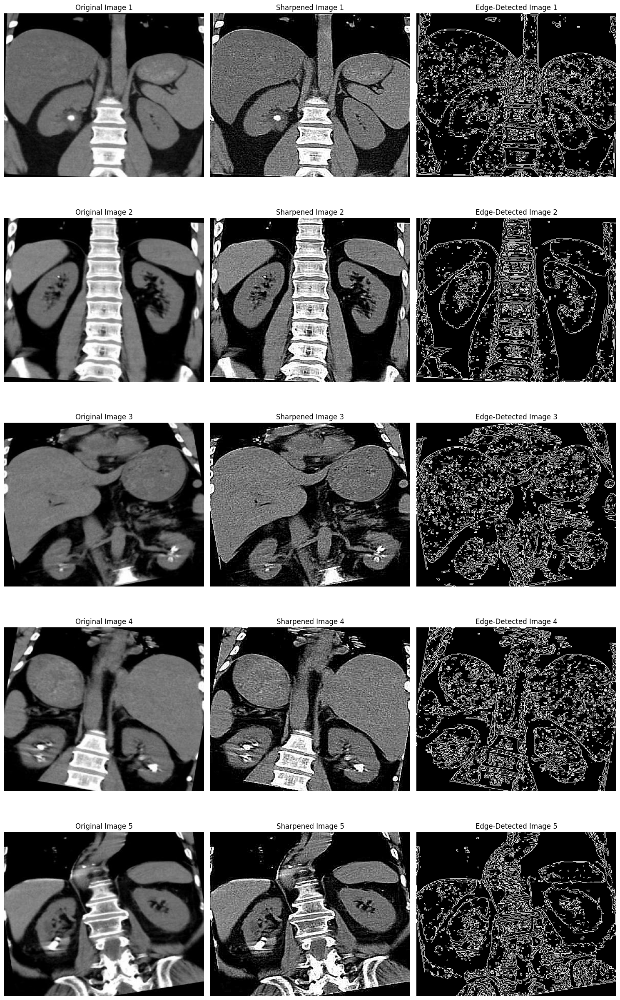

In [113]:
import numpy as np
fig, axes = plt.subplots(experiment_images, 3, figsize=(15, 5 * experiment_images))

# Loop through all images in the folder
for i, image_path in enumerate(image_files):

    # Read the original image
    original_image = cv2.imread(image_path)

    # Sharpen the image using a kernel (Laplacian filter)
    sharpened_image = cv2.filter2D(original_image, -1, np.array([[-1, -1, -1],
                                                                 [-1, 9, -1],
                                                                 [-1, -1, -1]]))

    # Perform edge detection using the Canny edge detector on the sharpened image
    edge_image = cv2.Canny(sharpened_image, 200, 300)  

    # Display the original, sharpened, and edge-detected images using Matplotlib
    axes[i, 0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title(f"Original Image {i+1}")
    axes[i, 0].axis('off')

    axes[i, 1].imshow(cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2RGB))
    axes[i, 1].set_title(f"Sharpened Image {i+1}")
    axes[i, 1].axis('off')

    axes[i, 2].imshow(edge_image, cmap='gray')
    axes[i, 2].set_title(f"Edge-Detected Image {i+1}")
    axes[i, 2].axis('off')

    # Print the paths of the images being processed
    print(f"Original Image {i+1}: {image_path}")
    print(f"Sharpened Image {i+1}: Sharpened {image_path}")
    print(f"Edge-Detected Image {i+1}: Edge of {image_path}")

    if(i == experiment_images - 1):
        break

# Show the Matplotlib figure
plt.tight_layout()
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

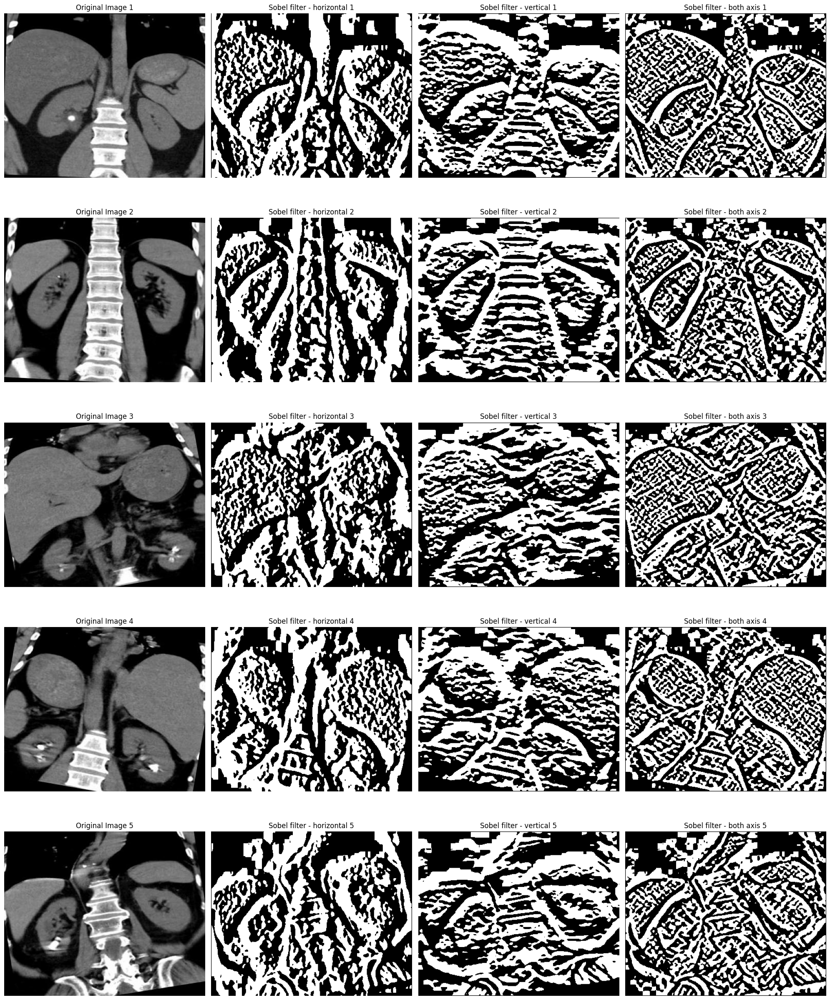

In [114]:
fig, axes = plt.subplots(experiment_images, 4, figsize=(20, 5 * experiment_images))

# Loop through all images in the folder
for i, image_path in enumerate(image_files):

    # Read the original image
    original_image = cv2.imread(image_path)
    # gray_image = cv2.imread(image_path, cv2.COLOR_BGR2GRAY)
    img_blur = cv2.GaussianBlur(original_image, (3,3), 0) 
 
    # Sobel Edge Detection
    sobelx = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=19) # Sobel Edge Detection on the X axis
    sobely = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=19) # Sobel Edge Detection on the Y axis
    sobelxy = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=19)

    # Display the original, sharpened, and edge-detected images using Matplotlib
    axes[i, 0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title(f"Original Image {i+1}")
    axes[i, 0].axis('off')

    axes[i, 1].imshow(sobelx, cmap='gray')
    axes[i, 1].set_title(f"Sobel filter - horizontal {i+1}")
    axes[i, 1].axis('off')

    axes[i, 2].imshow(sobely)
    axes[i, 2].set_title(f"Sobel filter - vertical {i+1}")
    axes[i, 2].axis('off')

    axes[i, 3].imshow(sobelxy)
    axes[i, 3].set_title(f"Sobel filter - both axis {i+1}")
    axes[i, 3].axis('off')

    if(i == experiment_images-1):
        break


# Show the Matplotlib figure
plt.tight_layout()
plt.show()


## K means done on the canny filtered image

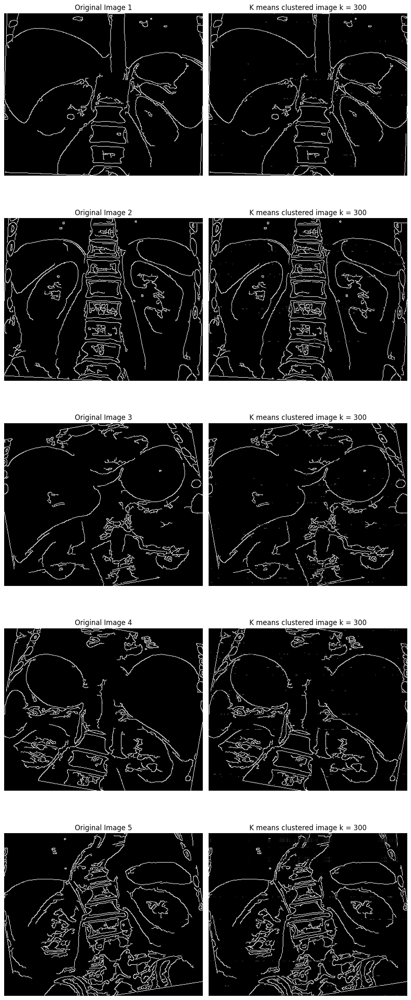

In [38]:
# k-means clustering

fig, axes = plt.subplots(experiment_images, 2, figsize=(10, 5 * experiment_images))

# Loop through all images in the folder
for i, image_path in enumerate(image_files):

    # Read the original image
    original_image = cv2.imread(image_path)
    original_image = cv2.Canny(original_image, 50, 300)
    # print(original_image.shape) 
    # pixel_vals = original_image.reshape((-1,3))
    pixel_vals = np.float32(original_image)

    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.85)

    k = 300
    retval, labels, centers = cv2.kmeans(pixel_vals, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    
    # convert data into 8-bit values
    centers = np.uint8(centers)
    
    segmented_data = centers[labels.flatten()]
    
    # reshape data into the original image dimensions
    segmented_image = segmented_data.reshape((original_image.shape))
    
    # segmented_data.shape

    # Display the original, sharpened, and edge-detected images using Matplotlib
    axes[i, 0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title(f"Original Image {i+1}")
    axes[i, 0].axis('off')

    axes[i, 1].imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
    axes[i, 1].set_title(f"K means clustered image k = {k}")
    axes[i, 1].axis('off')


    if(i == experiment_images-1):
        break


# Show the Matplotlib figure
plt.tight_layout()
plt.show()


## Region groeing algorithm - with random seed points

In [50]:
import cv2
import matplotlib.pyplot as plt

import numpy as np
import random


class Stack():
    def __init__(self):
        self.item = []
        self.obj=[]
    def push(self, value):
        self.item.append(value)

    def pop(self):
        return self.item.pop()

    def size(self):
        return len(self.item)

    def isEmpty(self):
        return self.size() == 0

    def clear(self):
        self.item = []

class regionGrow():
  
    def __init__(self,im_path,th):
        self.readImage(im_path)
        self.h, self.w,_ =  self.im.shape
        self.passedBy = np.zeros((self.h,self.w), np.double)
        self.currentRegion = 0
        self.iterations=0
        self.SEGS=np.zeros((self.h,self.w,3), dtype='uint8')
        self.stack = Stack()
        self.thresh=float(th)
    def readImage(self, img_path):
        self.im = cv2.imread(img_path,1)
    

    def getNeighbour(self, x0, y0):
        neighbour = []
        for i in (-1,0,1):
            for j in (-1,0,1):
                if (i,j) == (0,0): 
                    continue
                x = x0+i
                y = y0+j
                if self.limit(x,y):
                    neighbour.append((x,y))
        return neighbour
    def ApplyRegionGrow(self, axes, index):
        randomseeds=[[self.h/2,self.w/2],
            [self.h/3,self.w/3],[2*self.h/3,self.w/3],[self.h/3-10,self.w/3],
            [self.h/3,2*self.w/3],[2*self.h/3,2*self.w/3],[self.h/3-10,2*self.w/3],
            [self.h/3,self.w-10],[2*self.h/3,self.w-10],[self.h/3-10,self.w-10]
                    ]
        # print("Height ",self.h)
        # print("Width ",self.w)
        np.random.shuffle(randomseeds)
        for x0 in range (self.h):
            for y0 in range (self.w):
         
                if self.passedBy[x0,y0] == 0 and (int(self.im[x0,y0,0])*int(self.im[x0,y0,1])*int(self.im[x0,y0,2]) > 0) :  
                    self.currentRegion += 1
                    self.passedBy[x0,y0] = self.currentRegion
                    self.stack.push((x0,y0))
                    self.prev_region_count=0
                    while not self.stack.isEmpty():
                        x,y = self.stack.pop()
                        self.BFS(x,y)
                        self.iterations+=1
                    if(self.PassedAll()):
                        break
                    if(self.prev_region_count<8*8):     
                        self.passedBy[self.passedBy==self.currentRegion]=0
                        x0=random.randint(x0-4,x0+4)
                        y0=random.randint(y0-4,y0+4)
                        x0=max(0,x0)
                        y0=max(0,y0)
                        x0=min(x0,self.h-1)
                        y0=min(y0,self.w-1)
                        self.currentRegion-=1

        for i in range(0,self.h):
            for j in range (0,self.w):
                val = self.passedBy[i][j]
                if(val==0):
                    self.SEGS[i][j]=255,255,255
                else:
                    self.SEGS[i][j]=val*35,val*90,val*30
        if(self.iterations>200000):
            print("Max Iterations")

        axes[index, 0].imshow(cv2.cvtColor(self.im, cv2.COLOR_BGR2RGB))
        axes[index, 0].set_title(f"Original Image {index+1}")
        axes[index, 0].axis('off')

        axes[index, 1].imshow(cv2.cvtColor(self.SEGS, cv2.COLOR_BGR2RGB))
        axes[index, 1].set_title(f"Segmentation for Region Growing Algrithom")
        axes[index, 1].axis('off')

    def BFS(self, x0,y0):
        regionNum = self.passedBy[x0,y0]
        elems=[]
        elems.append((int(self.im[x0,y0,0])+int(self.im[x0,y0,1])+int(self.im[x0,y0,2]))/3)
        var=self.thresh
        neighbours=self.getNeighbour(x0,y0)
        
        for x,y in neighbours:
            if self.passedBy[x,y] == 0 and self.distance(x,y,x0,y0)<var:
                if(self.PassedAll()):
                    break
                self.passedBy[x,y] = regionNum
                self.stack.push((x,y))
                elems.append((int(self.im[x,y,0])+int(self.im[x,y,1])+int(self.im[x,y,2]))/3)
                var=np.var(elems)
                self.prev_region_count+=1
            var=max(var,self.thresh)
                
    
    
    def PassedAll(self):
   
        return self.iterations>200000 or np.count_nonzero(self.passedBy > 0) == self.w*self.h


    def limit(self, x,y):
        return  0<=x<self.h and 0<=y<self.w
    def distance(self,x,y,x0,y0):
        return ((int(self.im[x,y,0])-int(self.im[x0,y0,0]))**2+(int(self.im[x,y,1])-int(self.im[x0,y0,1]))**2+(int(self.im[x,y,2])-int(self.im[x0,y0,2]))**2)**0.5


Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations
Max Iterations


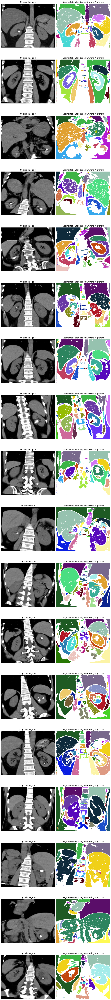

In [52]:

fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

# Loop through all images in the folder
for i, image_path in enumerate(image_files):

    region_grow_obj = regionGrow(image_path,5)
    region_grow_obj.ApplyRegionGrow(axes,i)



# Show the Matplotlib figure
plt.tight_layout()
plt.show()



## Get the kidney stone coordinates

In [57]:
fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

# Define the folder containing the labels
folder_path = "kidney_segmentation/labels/"

# Ensure the folder path exists
if not os.path.exists(folder_path):
    print(f"Folder '{folder_path}' not found.")
    exit()

# Get a list of image files in the folder
label_files = [os.path.join(folder_path, file) for file in os.listdir(folder_path) ]
# Loop through all images in the folder
for i, label_path in enumerate(label_files):

    # Open the file for reading
    with open(label_path, 'r') as file:
        # Read each line in the file
        for line in file:
            # Split the line into individual values based on spaces
            values = line.strip().split()

            # Convert the values to the appropriate data types (float in this case)
            values = [float(val) for val in values]

            # Now 'values' contains the numerical values from the line
            print(values[1],values[2])
            break


0.3312020460358056 0.6359375
0.6521739130434783 0.6640625
0.3273657289002558 0.615625
0.35805626598465473 0.6671875
0.3248081841432225 0.6046875
0.34782608695652173 0.6515625
0.7250639386189258 0.6890625
0.7519181585677749 0.628125
0.24936061381074168 0.6359375
0.710997442455243 0.7140625
0.32225063938618925 0.7484375
0.690537084398977 0.7328125
0.717391304347826 0.7203125
0.30562659846547313 0.7515625
0.6777493606138107 0.76875
0.7365728900255755 0.6890625
0.2710997442455243 0.403125
0.28005115089514065 0.375
0.2672634271099744 0.646875
0.7020460358056266 0.7015625
0.3171355498721228 0.5671875
0.31074168797953966 0.5265625
0.27365728900255754 0.346875
0.2672634271099744 0.3609375
0.7416879795396419 0.3515625
0.24168797953964194 0.3984375
0.7480818414322251 0.36875
0.7634271099744245 0.4234375
0.289002557544757 0.8640625
0.7774936061381074 0.790625
0.20332480818414322 0.8015625
0.2071611253196931 0.8078125
0.7915601023017903 0.921875
0.18414322250639387 0.8953125
0.7659846547314578 0.8

## Get the kidney stone coordinates

shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63700700749865510700001-5062181202000819812_png_jpg.rf.269520bcaab75e008e00f57f3fa98851.txt
129 203
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63705452817813079700001-4930177024992105378_png_jpg.rf.6b480b2d494a96b4e2d4143fa12b6f92.txt
104 115
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63705534437778071900001-4889285351602499583_png_jpg.rf.285306b4b622f3066164f801d91bce86.txt
112 276
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63705534438143092800001-5016478893295994883_png_jpg.rf.b884ac25dda52a8f2b20a7ebbba61300.txt
290 273
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63705540012455925300001-4745307433721610443_png_jpg.rf.5e9926e37e7719690a0e91b6ecdd7786.txt
103 207
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63713555111494863300001-5727337442320909856_png_jpg.rf.5a95a32bbcb2e4168fd6a5ae718d9498.txt
115 172
shape :  320 391
kidne

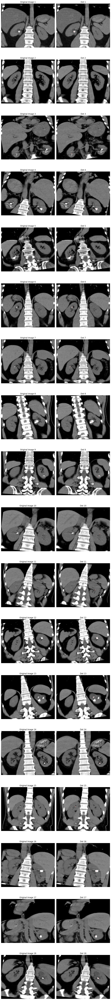

In [92]:
fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

for i, image_path_1 in enumerate(image_files):

    # Read the original image
    original_image = cv2.imread(image_path_1)
    print( "shape : " , original_image.shape[0] , original_image.shape[1] )

    original_image_copy = cv2.imread(image_path_1)
    
    lable_path = "kidney_segmentation/labels/"+image_path_1.split("/")[1].split(".jpg")[0]+".txt"

    print(lable_path)

# for i, label_path in enumerate(label_files):
    with open(lable_path, 'r') as file:
        # Read each line in the file
        for line in file:
            # Split the line into individual values based on spaces
            values = line.strip().split()

            # Convert the values to the appropriate data types (float in this case)
            values = [float(val) for val in values]

            # Now 'values' contains the numerical values from the line
            x = values[1]
            y = values[2]
            break

    dot_x = int(x * original_image.shape[1])
    dot_y = int(y * original_image.shape[0])

    

    print(dot_x, dot_y)
    dot_color = (0, 0, 255)

    # Draw the dot on the image  on the kidney coordinated
    cv2.circle(original_image, (dot_x, dot_y), 1, dot_color, -1)  # -1 means filled circle

    # Display the original and edge-detected images using Matplotlib
    axes[i, 0].imshow(cv2.cvtColor(original_image_copy, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title(f"Original Image {i+1}")
    axes[i, 0].axis('off')

    axes[i, 1].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[i, 1].set_title(f"Dot {i+1}")
    axes[i, 1].axis('off')


# Show the Matplotlib figure
plt.tight_layout()
plt.show()

## Kidney segementation - Region growing algorithm - seed points near the kidney stone

In [115]:
import cv2
import numpy as np


#class pour une pile
class Stack():
    def __init__(self):
        self.item = []
        self.obj=[]
    def push(self, value):
        self.item.append(value)

    def pop(self):
        return self.item.pop()

    def size(self):
        return len(self.item)

    def isEmpty(self):
        return self.size() == 0

    def clear(self):
        self.item = []

class regionGrow():
  
    def __init__(self,im_path,th):
        self.readImage(im_path)
        self.h, self.w,_ =  self.im.shape
        self.passedBy = np.zeros((self.h,self.w), np.double)
        self.currentRegion = 0
        self.iterations=0
        self.SEGS=np.zeros((self.h,self.w,3), dtype='uint8')
        self.stack = Stack()
        self.thresh=float(th)
    def readImage(self, img_path):
        self.im = cv2.imread(img_path,1)
    

    def getNeighbour(self, x0, y0):
        neighbour = []
        for i in (-1,0,1):
            for j in (-1,0,1):
                if (i,j) == (0,0): 
                    continue
                x = x0+i
                y = y0+j
                if self.limit(x,y):
                    neighbour.append((x,y))
        return neighbour
    def ApplyRegionGrow(self,seeds,axes,index):
        temp=[]
        for i in seeds:
            temp.append(i)
            temp.extend(self.getNeighbour(i[0],i[1]))
        seeds=temp
        for i in (seeds):
            x0=int(i[0])
            y0=int(i[1])
         
            if self.passedBy[x0,y0] == 0 and (int(self.im[x0,y0,0])*int(self.im[x0,y0,1])*int(self.im[x0,y0,2]) > 0) :  
                self.currentRegion += 1
                self.passedBy[x0,y0] = self.currentRegion
                self.stack.push((x0,y0))
                while not self.stack.isEmpty():
                    x,y = self.stack.pop()
                    self.BFS(x,y)
                    self.iterations+=1
                if(self.PassedAll()):
                    break
                count = np.count_nonzero(self.passedBy == self.currentRegion)
                if(count<8*8):     
                    self.passedBy[self.passedBy==self.currentRegion]=0
                    x0-=1
                    y0-=1   
                    self.currentRegion-=1

        for i in range(0,self.h):
            for j in range (0,self.w):
                val = self.passedBy[i][j]
                if(val==0):
                    self.SEGS[i][j]=255,255,255
                else:
                    self.SEGS[i][j]=val*35,val*90,val*30
        if(self.iterations>200000):
            print("Max Iterations")
       
        axes[index, 0].imshow(cv2.cvtColor(self.im, cv2.COLOR_BGR2RGB))
        axes[index, 0].set_title(f"Original Image {index+1}")
        axes[index, 0].axis('off')

        axes[index, 1].imshow(cv2.cvtColor(self.SEGS, cv2.COLOR_BGR2RGB))
        axes[index, 1].set_title(f"Segmentation for Region Growing Algrithom - with seed point")
        axes[index, 1].axis('off')
        # cv2.waitKey(0)
        # cv2.destroyAllWindows()
    def BFS(self, x0,y0):
        regionNum = self.passedBy[x0,y0]
        elems=[]
        elems.append((int(self.im[x0,y0,0])+int(self.im[x0,y0,1])+int(self.im[x0,y0,2]))/3)
        var=self.thresh
        neighbours=self.getNeighbour(x0,y0)
        
        for x,y in neighbours:
            if self.passedBy[x,y] == 0 and self.distance(x,y,x0,y0)<var:
                if(self.PassedAll()):
                    break
                self.passedBy[x,y] = regionNum
                self.stack.push((x,y))
                elems.append((int(self.im[x,y,0])+int(self.im[x,y,1])+int(self.im[x,y,2]))/3)
                var=np.var(elems)
            var=max(var,self.thresh)
                
    
    
    def PassedAll(self):
   
        return self.iterations>200000 or np.count_nonzero(self.passedBy > 0) == self.w*self.h


    def limit(self, x,y):
        return  0<=x<self.h and 0<=y<self.w
    def distance(self,x,y,x0,y0):
        return ((int(self.im[x,y,0])-int(self.im[x0,y0,0]))**2+(int(self.im[x,y,1])-int(self.im[x0,y0,1]))**2+(int(self.im[x,y,2])-int(self.im[x0,y0,2]))**2)**0.5







shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63700700749865510700001-5062181202000819812_png_jpg.rf.269520bcaab75e008e00f57f3fa98851.txt
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63705452817813079700001-4930177024992105378_png_jpg.rf.6b480b2d494a96b4e2d4143fa12b6f92.txt
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63705534437778071900001-4889285351602499583_png_jpg.rf.285306b4b622f3066164f801d91bce86.txt
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63705534438143092800001-5016478893295994883_png_jpg.rf.b884ac25dda52a8f2b20a7ebbba61300.txt
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63705540012455925300001-4745307433721610443_png_jpg.rf.5e9926e37e7719690a0e91b6ecdd7786.txt
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-63713555111494863300001-5727337442320909856_png_jpg.rf.5a95a32bbcb2e4168fd6a5ae718d9498.txt
shape :  320 391
kidney_segmentation/labels/1-3-46-670589-33-1-6371364

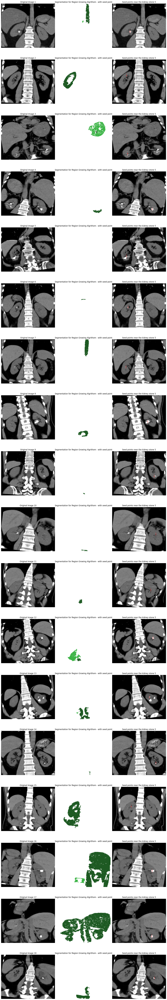

In [116]:
def Test_Affiche(event,x,y,flags,param):
    global seeds
    if event == cv2.EVENT_RBUTTONDOWN:
        cv2.destroyAllWindows()
        
    if event == cv2.EVENT_LBUTTONDOWN:
        seeds.append([y,x])


fig, axes = plt.subplots(num_images, 3, figsize=(15, 5 * num_images))

for index, image_path_1 in enumerate(image_files):

    # Read the original image
    original_image = cv2.imread(image_path_1)
    print( "shape : " , original_image.shape[0] , original_image.shape[1] )

    original_image_copy = cv2.imread(image_path_1)
    
    lable_path = "kidney_segmentation/labels/"+image_path_1.split("/")[1].split(".jpg")[0]+".txt"

    print(lable_path)

# for i, label_path in enumerate(label_files):
    with open(lable_path, 'r') as file:
        # Read each line in the file
        for line in file:
            # Split the line into individual values based on spaces
            values = line.strip().split()

            # Convert the values to the appropriate data types (float in this case)
            values = [float(val) for val in values]

            # Now 'values' contains the numerical values from the line
            x = values[1]
            y = values[2]
            break

    dot_x = int(x * original_image.shape[1])
    dot_y = int(y * original_image.shape[0])

    dot_color = (0, 0, 255)

    # Draw the dot on the image
    cv2.circle(original_image, (dot_x+2, dot_y), 1, dot_color, -1)  # -1 means filled circle
    cv2.circle(original_image, (dot_x-2, dot_y), 1, dot_color, -1)  # -1 means filled circle
    cv2.circle(original_image, (dot_x, dot_y+2), 1, dot_color, -1)  # -1 means filled circle
    cv2.circle(original_image, (dot_x, dot_y-2), 1, dot_color, -1)  # -1 means filled circle
    cv2.circle(original_image, (dot_x, dot_y+12), 1, dot_color, -1) 
    cv2.circle(original_image, (dot_x, dot_y-12), 1, dot_color, -1) 
    # cv2.circle(original_image, (dot_x+200, dot_y), 1, dot_color, -1)  # -1 means filled circle

    # # Display the original and edge-detected images using Matplotlib
    # axes[i, 0].imshow(cv2.cvtColor(original_image_copy, cv2.COLOR_BGR2RGB))
    # axes[i, 0].set_title(f"Original Image {i+1}")
    # axes[i, 0].axis('off')

    


    
    
    seeds=[[dot_x,dot_y+13],[dot_x,dot_y-13],[dot_x,dot_y+12],[dot_x,dot_y-12]]

    exemple = regionGrow(image_path_1,5)
    exemple.ApplyRegionGrow(seeds, axes, index)

    axes[index, 2].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[index, 2].set_title(f"Seed points near the kidney stone {i+1}")
    axes[index, 2].axis('off')


# Show the Matplotlib figure
plt.tight_layout()
plt.show()
